In [1]:
pip install --pre pycaret

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [2]:
from pycaret.datasets import get_data
data = get_data('SolarPrediction')

,UNIXTime,Data,Time,Radiation,Temperature,Pressure,Humidity,WindDirection(Degrees),Speed,TimeSunRise,TimeSunSet
0,1475229326,9/29/2016 12:00:00 AM,23:55:26,1.21,48,30.46,59,177.39,5.62,06:13:00,18:13:00
1,1475229023,9/29/2016 12:00:00 AM,23:50:23,1.21,48,30.46,58,176.78,3.37,06:13:00,18:13:00
2,1475228726,9/29/2016 12:00:00 AM,23:45:26,1.23,48,30.46,57,158.75,3.37,06:13:00,18:13:00
3,1475228421,9/29/2016 12:00:00 AM,23:40:21,1.21,48,30.46,60,137.71,3.37,06:13:00,18:13:00
4,1475228124,9/29/2016 12:00:00 AM,23:35:24,1.17,48,30.46,62,104.95,5.62,06:13:00,18:13:00


In [3]:
from pycaret.regression import *
s = setup(data, target = 'Radiation')

,Description,Value
0,Session id,7581
1,Target,Radiation
2,Target type,Regression
3,Data shape,"(32686, 11)"
4,Train data shape,"(22880, 11)"
5,Test data shape,"(9806, 11)"
6,Numeric features,6
7,Categorical features,4
8,Preprocess,True
9,Imputation type,simple


In [5]:
best = compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
knn,K Neighbors Regressor,27.1588,5786.4575,75.9766,0.9419,0.2639,0.1779,0.1460
et,Extra Trees Regressor,58.2171,13471.2252,115.9061,0.8648,1.0679,4.4352,1.4430
lightgbm,Light Gradient Boosting Machine,70.2160,17009.1888,130.2706,0.8292,1.3828,6.8755,0.2090
gbr,Gradient Boosting Regressor,74.7504,17012.7329,130.3723,0.8291,1.5856,9.4887,1.3740
rf,Random Forest Regressor,68.4648,17936.2209,133.7892,0.8199,1.1738,5.8897,3.6120
xgboost,Extreme Gradient Boosting,93.1984,23443.6891,152.9057,0.7646,1.9861,16.4207,1.0150
ridge,Ridge Regression,118.6784,27885.3494,166.9747,0.7198,2.4384,30.6436,0.1260
lr,Linear Regression,118.6736,27884.7347,166.9728,0.7198,2.4382,30.6312,0.6380
br,Bayesian Ridge,118.6906,27887.3410,166.9807,0.7197,2.4388,30.6704,0.1360
lasso,Lasso Regression,119.5128,28113.9005,167.6586,0.7175,2.4566,31.5175,0.1300


Processing:   0%|          | 0/81 [00:00<?, ?it/s]

In [6]:
print(best)

KNeighborsRegressor(n_jobs=-1)


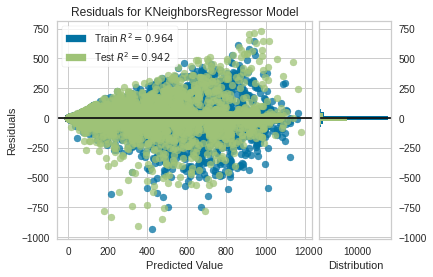

In [8]:
plot_model(best, plot = 'residuals')

In [10]:
predict_model(best)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,K Neighbors Regressor,26.5748,5796.5747,76.1352,0.9423,0.2637,0.1748


,UNIXTime,Data,Time,Temperature,Pressure,Humidity,WindDirection(Degrees),Speed,TimeSunRise,TimeSunSet,Radiation,prediction_label
22880,1.474753e+09,181.373739,206.981017,63.0,30.480000,82.0,13.570000,7.87,230.363125,181.373739,1219.119995,706.797974
22881,1.473718e+09,152.569421,636.453339,63.0,30.500000,78.0,273.730011,7.87,107.214371,152.569421,160.850006,183.263992
22882,1.481703e+09,214.092636,1.203750,39.0,30.330000,93.0,157.869995,5.62,149.326470,185.179867,1.220000,1.240000
22883,1.475525e+09,124.807260,696.733327,55.0,30.469999,99.0,88.279999,11.25,154.072933,124.807260,495.760010,490.024017
22884,1.479756e+09,231.998392,571.842004,56.0,30.450001,84.0,137.479996,9.00,190.439646,185.048574,537.760010,530.591980
...,...,...,...,...,...,...,...,...,...,...,...,...
32681,1.478652e+09,189.772211,380.723338,56.0,30.389999,87.0,63.080002,3.37,217.240366,185.179867,203.279999,199.868011
32682,1.481546e+09,80.810685,206.981017,48.0,30.360001,95.0,250.639999,2.25,149.326470,185.179867,1.270000,1.302000
32683,1.481846e+09,112.743046,594.055549,49.0,30.219999,99.0,309.149994,9.00,180.111840,221.441931,161.460007,154.828003
32684,1.480290e+09,236.624256,370.446002,57.0,30.430000,76.0,46.709999,6.75,238.563122,185.048574,799.770020,735.828003


In [11]:
predictions = predict_model(best, data=data)
predictions.head()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,K Neighbors Regressor,22.4221,4248.6445,65.1816,0.9574,0.2156,0.1327


,UNIXTime,Data,Time,Temperature,Pressure,Humidity,WindDirection(Degrees),Speed,TimeSunRise,TimeSunSet,Radiation,prediction_label
0,1.475229e+09,328.053969,206.981017,48.0,30.459999,59.0,177.389999,5.62,274.717671,328.053969,1.21,1.204
1,1.475229e+09,328.053969,1.215000,48.0,30.459999,58.0,176.779999,3.37,274.717671,328.053969,1.21,1.204
2,1.475229e+09,328.053869,1.240000,48.0,30.459999,57.0,158.750000,3.37,274.717645,328.053869,1.23,1.204
3,1.475228e+09,328.053969,1.352000,48.0,30.459999,60.0,137.710007,3.37,274.717671,328.053969,1.21,1.204
4,1.475228e+09,328.054170,1.230000,48.0,30.459999,62.0,104.949997,5.62,274.717722,328.054170,1.17,1.204


In [12]:
save_model(best, 'my_best_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=/tmp/joblib),
          steps=[('numerical_imputer',
                  TransformerWrapper(include=['UNIXTime', 'Temperature',
                                              'Pressure', 'Humidity',
                                              'WindDirection(Degrees)',
                                              'Speed'],
                                     transformer=SimpleImputer())),
                 ('categorical_imputer',
                  TransformerWrapper(include=['Data', 'Time', 'TimeSunRise',
                                              'TimeSunSet'],
                                     transformer=SimpleImputer(fill_value='constan...
                 ('rest_encoding',
                  TransformerWrapper(include=['Data', 'Time', 'TimeSunRise',
                                              'TimeSunSet'],
                                     transformer=LeaveOneOutEncoder(cols=['Data',
                                                       

In [13]:
loaded_model = load_model('my_best_pipeline')
print(loaded_model)

Transformation Pipeline and Model Successfully Loaded
Pipeline(memory=Memory(location=/tmp/joblib),
         steps=[('numerical_imputer',
                 TransformerWrapper(include=['UNIXTime', 'Temperature',
                                             'Pressure', 'Humidity',
                                             'WindDirection(Degrees)',
                                             'Speed'],
                                    transformer=SimpleImputer())),
                ('categorical_imputer',
                 TransformerWrapper(include=['Data', 'Time', 'TimeSunRise',
                                             'TimeSunSet'],
                                    transformer=SimpleImputer(fill_value='constan...
                ('rest_encoding',
                 TransformerWrapper(include=['Data', 'Time', 'TimeSunRise',
                                             'TimeSunSet'],
                                    transformer=LeaveOneOutEncoder(cols=['Data',
                

In [1]:
import plotly.graph_objects as go

import pandas as pd

# Read data from a csv
z_data = pd.read_csv('SolarPrediction.csv')

fig = go.Figure(data=[go.Surface(z=z_data.values)])

fig.update_layout(title='Hello', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

fig.show()

In [3]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np
# Read data from a csv
z_data = pd.read_csv('SolarPrediction.csv')
z = z_data.values
sh_0, sh_1 = z.shape
x, y = np.linspace(0, 1, sh_0), np.linspace(0, 1, sh_1)
fig = go.Figure(data=[go.Surface(z=z, x=x, y=y)])
fig.update_layout(title='Hello', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

In [5]:
import plotly.graph_objects as go

import pandas as pd

# Read data from a csv
z_data = pd.read_csv('SolarPrediction.csv')

fig = go.Figure(data=[go.Surface(z=z_data.values)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Hello', autosize=False,
                  scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90)
)

fig.show()

In [6]:
import plotly.graph_objects as go

fig = go.Figure(go.Surface(
    contours = {
        "x": {"show": True, "start": 1.5, "end": 2, "size": 0.04, "color":"white"},
        "z": {"show": True, "start": 0.5, "end": 0.8, "size": 0.05}
    },
    x = [1,2,3,4,5],
    y = [1,2,3,4,5],
    z = [
        [0, 1, 0, 1, 0],
        [1, 0, 1, 0, 1],
        [0, 1, 0, 1, 0],
        [1, 0, 1, 0, 1],
        [0, 1, 0, 1, 0]
    ]))
fig.update_layout(
        scene = {
            "xaxis": {"nticks": 20},
            "zaxis": {"nticks": 4},
            'camera_eye': {"x": 0, "y": -1, "z": 0.5},
            "aspectratio": {"x": 1, "y": 1, "z": 0.2}
        })
fig.show()

In [7]:
import plotly.graph_objects as go
import numpy as np

z1 = np.array([
    [8.83,8.89,8.81,8.87,8.9,8.87],
    [8.89,8.94,8.85,8.94,8.96,8.92],
    [8.84,8.9,8.82,8.92,8.93,8.91],
    [8.79,8.85,8.79,8.9,8.94,8.92],
    [8.79,8.88,8.81,8.9,8.95,8.92],
    [8.8,8.82,8.78,8.91,8.94,8.92],
    [8.75,8.78,8.77,8.91,8.95,8.92],
    [8.8,8.8,8.77,8.91,8.95,8.94],
    [8.74,8.81,8.76,8.93,8.98,8.99],
    [8.89,8.99,8.92,9.1,9.13,9.11],
    [8.97,8.97,8.91,9.09,9.11,9.11],
    [9.04,9.08,9.05,9.25,9.28,9.27],
    [9,9.01,9,9.2,9.23,9.2],
    [8.99,8.99,8.98,9.18,9.2,9.19],
    [8.93,8.97,8.97,9.18,9.2,9.18]
])

z2 = z1 + 1
z3 = z1 - 1

fig = go.Figure(data=[
    go.Surface(z=z1),
    go.Surface(z=z2, showscale=False, opacity=0.9),
    go.Surface(z=z3, showscale=False, opacity=0.9)

])

fig.show()

In [8]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Equation of ring cyclide
# see https://en.wikipedia.org/wiki/Dupin_cyclide
import numpy as np
a, b, d = 1.32, 1., 0.8
c = a**2 - b**2
u, v = np.mgrid[0:2*np.pi:100j, 0:2*np.pi:100j]
x = (d * (c - a * np.cos(u) * np.cos(v)) + b**2 * np.cos(u)) / (a - c * np.cos(u) * np.cos(v))
y = b * np.sin(u) * (a - d*np.cos(v)) / (a - c * np.cos(u) * np.cos(v))
z = b * np.sin(v) * (c*np.cos(u) - d) / (a - c * np.cos(u) * np.cos(v))

fig = make_subplots(rows=1, cols=2,
                    specs=[[{'is_3d': True}, {'is_3d': True}]],
                    subplot_titles=['Color corresponds to z', 'Color corresponds to distance to origin'],
                    )

fig.add_trace(go.Surface(x=x, y=y, z=z, colorbar_x=-0.07), 1, 1)
fig.add_trace(go.Surface(x=x, y=y, z=z, surfacecolor=x**2 + y**2 + z**2), 1, 2)
fig.update_layout(title_text="Ring cyclide")
fig.show()